# Wildfire Data Analysis

Analysis of US Government data regarding fires that occurred in the US from 1992 to 2015. This dataset includes 1.88 million geo-referenced wildfire reports. This analysis was inspired by the following questions:
1. Have fires become more or less frequent over time and can we spot seasonality in fires?
2. What areas are most impacted by fires and what areas suffer from the largest fires?
3. How have causes of fires and containment times changed over time?

## Preliminaries
We begin with downloading relevant packages and connecting to the SQL database harboring the different tables.

In [1]:
# Downloading relevant packages
import numpy as np
import pandas as pd
import datetime as dt
import scipy.stats as ss
from statistics import mode
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from matplotlib.animation import FuncAnimation
import matplotlib.ticker as ticker
import plotly.express as px
import seaborn as sns
import sqlite3

In [2]:
# Connecting to sql database using sqlite3
con = sqlite3.connect("wildfires.sqlite")
# Creating cursor to point to tables within the database
cur = con.cursor()

## Exploration
We now move on to explore the data more closely, creating Pandas DataFrames from the SQL database whenever necessary.

In [3]:
# Printing out all the table names within the wildfires database
wildfires_sql = cur.execute(
    """
    SELECT name 
    FROM sqlite_schema
    WHERE type='table'
    ORDER BY name;
    """
)
wildfires_sql.fetchall()

[('ElementaryGeometries',),
 ('Fires',),
 ('KNN',),
 ('NWCG_UnitIDActive_20170109',),
 ('SpatialIndex',),
 ('geometry_columns',),
 ('geometry_columns_auth',),
 ('geometry_columns_field_infos',),
 ('geometry_columns_statistics',),
 ('geometry_columns_time',),
 ('idx_Fires_Shape',),
 ('idx_Fires_Shape_node',),
 ('idx_Fires_Shape_parent',),
 ('idx_Fires_Shape_rowid',),
 ('spatial_ref_sys',),
 ('spatial_ref_sys_aux',),
 ('spatialite_history',),
 ('sql_statements_log',),
 ('sqlite_sequence',),
 ('views_geometry_columns',),
 ('views_geometry_columns_auth',),
 ('views_geometry_columns_field_infos',),
 ('views_geometry_columns_statistics',),
 ('virts_geometry_columns',),
 ('virts_geometry_columns_auth',),
 ('virts_geometry_columns_field_infos',),
 ('virts_geometry_columns_statistics',)]

The only tables we are interested in for the scope of this project are Fires, as it is the one that holds all the data regarding each fire, when it occurred, where it occurred, etc. and NWCG_UnitIDActive_20170109, as it holds information regarding the units that drafted the fire reports. The following are the important columns that we care about for each table:

Fires
- FOD_ID: Global unique identifier
- NWCG_REPORTING_AGENCY: National Wildlife Coordinating Group (NWCG) that prepared the fire report
- NWCG_REPORTING_UNIT_ID: Active NWCG unit name for unit preparing report
- DISCOVERY_DATE: Date on which fire was discovered/confirmed to exist
- DISCOVERY_TIME: Time of day that fire was discovered/confirmed to exist
- CONT_DATE: Date on which fire was declared contained/controlled
- CONT_TIME: Time of day that fire was declared contained/controlled
- STAT_CAUSE_DESCR: Description of statistical cause of fire
- FIRE_SIZE: Estimate of acres within final perimeter of the fire
- FIRE_SIZE_CLASS: Code for fire size based on acreage
- LATITUDE: Latitude for point location of fire
- LONGITUDE: Longitude for point location of fire
- STATE: State code in which the fire originated

NWCG_UnitIDActive_20170109
- UnitID: NWCG unit ID
- GeographicArea: Two letter code for area in which NWCG unit is located
- State: State code in which NWCG unit is located

In [4]:
# Running query to get table of all columns of interest for initial exploration
fires_sql = cur.execute(
    """
    SELECT FOD_ID, 
           NWCG_REPORTING_AGENCY, 
           n.GeographicArea AS NWCG_REPORTING_UNIT_GEO_AREA, 
           n.State AS NWCG_REPORTING_UNIT_STATE, 
           DATE(DISCOVERY_DATE), 
           DISCOVERY_TIME, 
           DATE(CONT_DATE), 
           CONT_TIME, 
           STAT_CAUSE_DESCR, 
           FIRE_SIZE, 
           FIRE_SIZE_CLASS, 
           LATITUDE, 
           LONGITUDE, 
           f.STATE
    FROM Fires f
    LEFT JOIN NWCG_UnitIDActive_20170109 n 
    ON f.NWCG_REPORTING_UNIT_ID = n.UnitID
    """
)
fires_df = pd.DataFrame(
    data = fires_sql.fetchall(),
    columns = ["id", 
               "reporting_agency", 
               "reporting_agency_geo_area", 
               "reporting_agency_state",
               "discovery_date",
               "discovery_time",
               "containment_date",
               "containment_time",
               "fire_cause",
               "fire_acres",
               "fire_size_class",
               "latitude",
               "longitude",
               "state_fire_origin"]
)

In [5]:
# Taking a quick look at the table
fires_df.head()

,id,reporting_agency,reporting_agency_geo_area,reporting_agency_state,discovery_date,discovery_time,containment_date,containment_time,fire_cause,fire_acres,fire_size_class,latitude,longitude,state_fire_origin
0,1,FS,CA,CA,2005-02-02,1300,2005-02-02,1730,Miscellaneous,0.10,A,40.036944,-121.005833,CA
1,2,FS,CA,CA,2004-05-12,0845,2004-05-12,1530,Lightning,0.25,A,38.933056,-120.404444,CA
2,3,FS,CA,CA,2004-05-31,1921,2004-05-31,2024,Debris Burning,0.10,A,38.984167,-120.735556,CA
3,4,FS,CA,CA,2004-06-28,1600,2004-07-03,1400,Lightning,0.10,A,38.559167,-119.913333,CA
4,5,FS,CA,CA,2004-06-28,1600,2004-07-03,1200,Lightning,0.10,A,38.559167,-119.933056,CA


In [6]:
# Looking for basic info of columns
fires_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1880465 entries, 0 to 1880464
Data columns (total 14 columns):
 #   Column                     Dtype  
---  ------                     -----  
 0   id                         int64  
 1   reporting_agency           object 
 2   reporting_agency_geo_area  object 
 3   reporting_agency_state     object 
 4   discovery_date             object 
 5   discovery_time             object 
 6   containment_date           object 
 7   containment_time           object 
 8   fire_cause                 object 
 9   fire_acres                 float64
 10  fire_size_class            object 
 11  latitude                   float64
 12  longitude                  float64
 13  state_fire_origin          object 
dtypes: float64(3), int64(1), object(10)
memory usage: 200.9+ MB


In [7]:
# Looking for statistical description of columns
fires_df.describe(include = "all")

,id,reporting_agency,reporting_agency_geo_area,reporting_agency_state,discovery_date,discovery_time,containment_date,containment_time,fire_cause,fire_acres,fire_size_class,latitude,longitude,state_fire_origin
count,1.880465e+06,1880465,1845708,1845708,1880465,997827,988934,908292,1880465,1.880465e+06,1880465,1.880465e+06,1.880465e+06,1880465
unique,NaN,11,9,52,8766,1440,8760,1441,13,NaN,7,NaN,NaN,52
top,NaN,ST/C&L,SA,CA,2008-02-10,1400,2011-02-19,1800,Debris Burning,NaN,B,NaN,NaN,CA
freq,NaN,1377090,923715,187834,1208,20981,841,38078,429028,NaN,939376,NaN,NaN,189550
mean,5.484020e+07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.452016e+01,NaN,3.678121e+01,-9.570494e+01,NaN
std,1.011963e+08,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.497598e+03,NaN,6.139031e+00,1.671694e+01,NaN
min,1.000000e+00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.000000e-05,NaN,1.793972e+01,-1.788026e+02,NaN
25%,5.055000e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.000000e-01,NaN,3.281860e+01,-1.103635e+02,NaN
50%,1.067761e+06,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.000000e+00,NaN,3.545250e+01,-9.204304e+01,NaN
75%,1.910639e+07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.300000e+00,NaN,4.082720e+01,-8.229760e+01,NaN


## 1. Have fires become more or less frequent over time and can we spot seasonality in fires?

Now we will take a look at fire count and severity (by size) changing over time by date, month, and year. To do this, we will query separate tables from the database depending on the goal at hand.

In [8]:
# We will begin by viewing total fire count and severity by date, month, and year.
# We will be defining severity by average size of fire
# Querying total fire count by date
by_date_sql = cur.execute(
    """
    SELECT COUNT(FIRE_SIZE), 
           AVG(FIRE_SIZE), 
           DATE(DISCOVERY_DATE)
    FROM Fires
    GROUP BY DATE(DISCOVERY_DATE)
    """
)
by_date_df = pd.DataFrame(
    data = by_date_sql.fetchall(),
    columns = ["fire_count", "avg_fire_size", "discovery_date"]
)
# Querying total fire count by month
by_month_sql = cur.execute(
    """
    SELECT COUNT(FIRE_SIZE), 
           AVG(FIRE_SIZE), 
           STRFTIME("%m", DATE(DISCOVERY_DATE))
    FROM Fires
    GROUP BY STRFTIME("%m", DATE(DISCOVERY_DATE))
    """
)
by_month_df = pd.DataFrame(
    data = by_month_sql.fetchall(),
    columns = ["fire_count", "avg_fire_size", "discovery_month"]
)
by_month_df["discovery_month"] = by_month_df["discovery_month"].replace(
    to_replace = {
        "01": "Jan",
        "02": "Feb",
        "03": "Mar",
        "04": "Apr",
        "05": "May",
        "06": "Jun",
        "07": "Jul",
        "08": "Aug",
        "09": "Sep",
        "10": "Oct",
        "11": "Nov",
        "12": "Dec"
    }
)
# Querying total fire count by year
by_year_sql = cur.execute(
    """
    SELECT COUNT(FIRE_SIZE), 
           AVG(FIRE_SIZE), 
           STRFTIME("%Y", DATE(DISCOVERY_DATE))
    FROM Fires
    GROUP BY STRFTIME("%Y", DATE(DISCOVERY_DATE))
    """
)
by_year_df = pd.DataFrame(
    data = by_year_sql.fetchall(),
    columns = ["fire_count", "avg_fire_size", "discovery_year"]
)

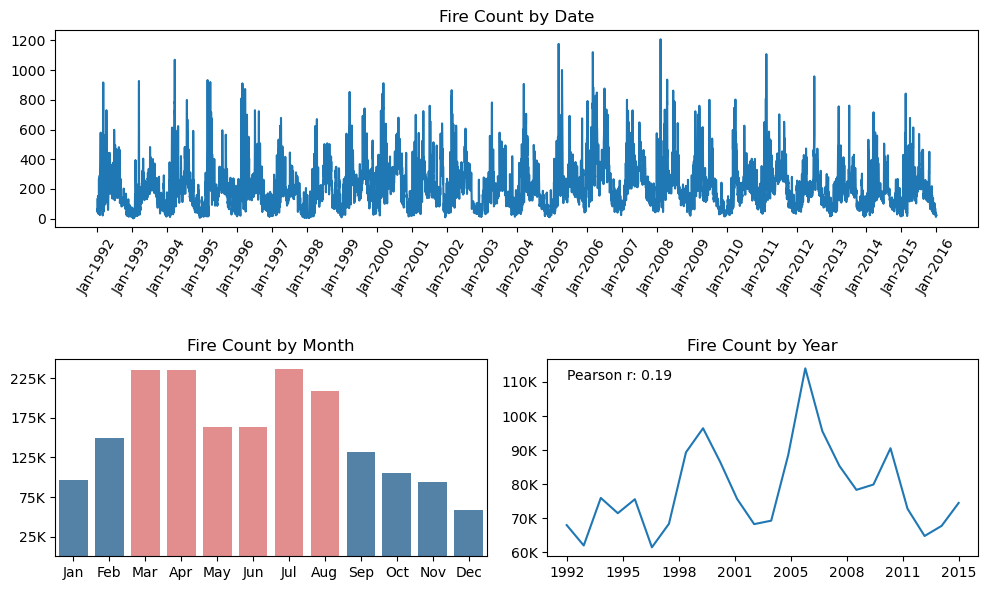

In [9]:
# Plotting dashboard for how average fire sizes have changed over time
fig = plt.figure(figsize = (10,6))
gs = GridSpec(nrows = 2, ncols = 2)
# Plotting fire count time series
ax0 = fig.add_subplot(gs[0,:])
sns.lineplot(
    data = by_date_df, 
    x = "discovery_date", 
    y = "fire_count",
    ax = ax0
)
ax0.set_xticks(
    ticks = np.linspace(0, len(by_date_df), 25), 
    labels = ["Jan-" + str(x) for x in np.linspace(1992,2016, 25, dtype = int)],
    rotation = 60
)
ax0.set_xlabel("")
ax0.set_ylabel("")
ax0.set_title("Fire Count by Date")
# Plotting fire count by month bar plot
ax1 = fig.add_subplot(gs[1,0])
cols = ["lightcoral" if x > 150000 else "steelblue" for x in by_month_df.fire_count]
sns.barplot(
    data = by_month_df,
    x = "discovery_month",
    y = "fire_count",
    palette = cols,
    ax = ax1
)
ax1.set_xlabel("")
ax1.set_yticks(
    ticks = np.linspace(25000, 225000, 5),
    labels = [str(int(x/1000)) + "K" for x in np.linspace(25000, 225000, 5)]
)
ax1.set_ylabel("")
ax1.set_title("Fire Count by Month")
# Plotting fire count over years lineplot
ax2 = fig.add_subplot(gs[1,1])
sns.lineplot(
    data = by_year_df,
    x = "discovery_year",
    y = "fire_count",
    ax = ax2
)
ax2.set_xticks(
    ticks = np.linspace(0, len(by_year_df)-1, 8),
    labels = np.linspace(1992, 2015, 8, dtype = int)
)
ax2.set_xlabel("")
ax2.set_yticks(
    ticks = np.linspace(60000, 110000, 6),
    labels = [str(int(x/1000)) + "K" for x in np.linspace(60000, 110000, 6)]
)
pr = ss.pearsonr(
    x = [float(x) for x in by_year_df.discovery_year],
    y = by_year_df.fire_count
)[0]
ax2.annotate(
    f"Pearson r: {pr:.2f}",
    xy = (90, 135),
    xycoords = "axes points",
    size = 10,
    ha = "right",
    va = "top"
)
ax2.set_ylabel("")
ax2.set_title("Fire Count by Year")
plt.tight_layout(h_pad = 3)
plt.show()

From above, we see that a seasonality does exist in terms of amount of fires that occur. It seems like there are more fires in the middle months covering the spring and summer seasons, whilst there are less fires in the months of the autumn and winter seasons. Finally, it seems like there is not that big of a correlation between year and fire count. Maybe average fire size will show something different.

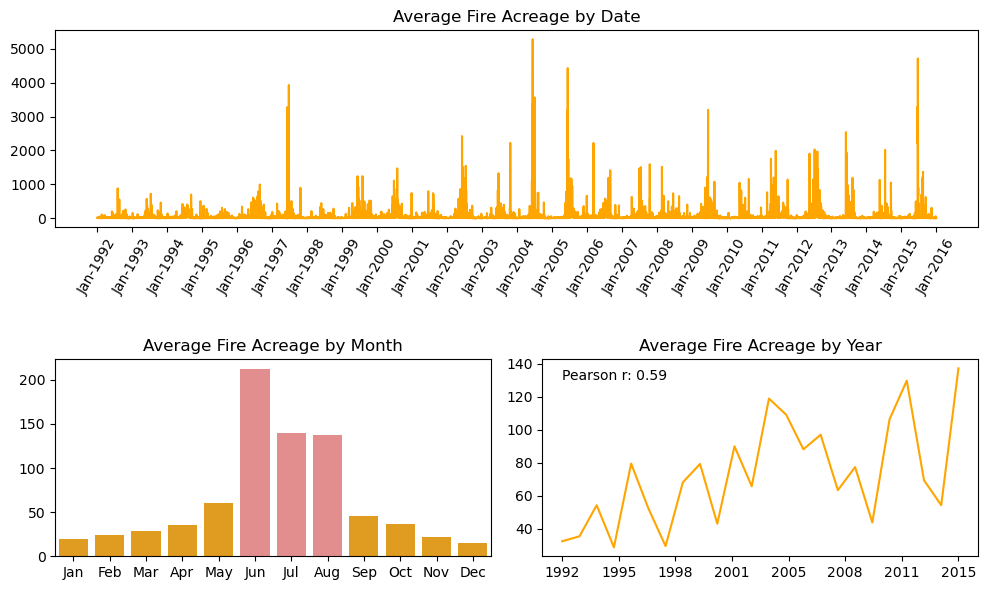

In [10]:
# Plotting dashboard for how average fire sizes have changed over time
fig = plt.figure(figsize = (10,6))
gs = GridSpec(nrows = 2, ncols = 2)
# Plotting fire count time series
ax0 = fig.add_subplot(gs[0,:])
sns.lineplot(
    data = by_date_df, 
    x = "discovery_date", 
    y = "avg_fire_size",
    color = "orange",
    ax = ax0
)
ax0.set_xticks(
    ticks = np.linspace(0, len(by_date_df), 25), 
    labels = ["Jan-" + str(x) for x in np.linspace(1992,2016, 25, dtype = int)],
    rotation = 60
)
ax0.set_xlabel("")
ax0.set_ylabel("")
ax0.set_title("Average Fire Acreage by Date")
# Plotting fire count by month bar plot
ax1 = fig.add_subplot(gs[1,0])
cols = ["lightcoral" if x > 100 else "orange" for x in by_month_df.avg_fire_size]
sns.barplot(
    data = by_month_df,
    x = "discovery_month",
    y = "avg_fire_size",
    palette = cols,
    ax = ax1
)
ax1.set_xlabel("")
ax1.set_ylabel("")
ax1.set_title("Average Fire Acreage by Month")
# Plotting fire count over years lineplot
ax2 = fig.add_subplot(gs[1,1])
sns.lineplot(
    data = by_year_df,
    x = "discovery_year",
    y = "avg_fire_size",
    color = "orange",
    ax = ax2
)
ax2.set_xticks(
    ticks = np.linspace(0, len(by_year_df)-1, 8),
    labels = np.linspace(1992, 2015, 8, dtype = int)
)
ax2.set_xlabel("")
pr1 = ss.pearsonr(
    x = [float(x) for x in by_year_df.discovery_year],
    y = by_year_df.avg_fire_size
)[0]
ax2.annotate(
    f"Pearson r: {pr1:.2f}",
    xy = (90, 135),
    xycoords = "axes points",
    size = 10,
    ha = "right",
    va = "top"
)
ax2.set_ylabel("")
ax2.set_title("Average Fire Acreage by Year")
plt.tight_layout(h_pad = 3)
plt.show()

The seasonality is also present for fire sizes, although somewhat more focalized in the summer months. Also, we can see that there is a higher correlation between year and average fire size, showing that while number of fires did not increase over the years, the average size of the fires did (which of course could be influenced by a general trend or a higher number of high-impact, large fires). 

## 2. What areas are most impacted by fires and what areas suffer from the largest fires?

Now we will take a look at fire count and severity (by size) in different areas across the country. To do this, we will query separate tables from the database depending on the goal at hand.

In [11]:
# We will begin by just plotting fire count by state
# Here we will query fire count, avg fire size, and state, grouping by state
by_state_sql = cur.execute(
    """
    SELECT COUNT(FIRE_SIZE),
           AVG(FIRE_SIZE),
           STATE
    FROM Fires
    GROUP BY STATE
    """
)
by_state_df = pd.DataFrame(
    data = by_state_sql.fetchall(),
    columns = ["fire_count", 
               "avg_fire_size",
               "state"]
)

In [12]:
# Now we plot the fire counts by state aggregated over all years on a map
# This map will be interactive
# Fire sizes can be seen if mouse is hovered over state
fig = px.choropleth(
    by_state_df, 
    custom_data = ["state", "fire_count", "avg_fire_size"],
    locations = "state",
    locationmode = "USA-states",
    color = "fire_count",
    color_continuous_scale = "OrRd",
    scope = "usa",
    labels = {"fire_count": "Fire Count"}
)
# Let's add average fire acreage to hover information
fig.update_traces(
    hovertemplate = "<br>".join(
        [
            "State: %{customdata[0]}",
            "Fire Count: %{customdata[1]:.d}",
            "Average Fire Acreage: %{customdata[2]:.2f}"
        ]
    )
)
# We remove the smaller state labels from the map to reduce clutter
small_states = ["VT", "NH", "CT", "RI", "MD", "DE", "DC", "WV", "MA", "NJ"]
big_states = [x for x in by_state_df.state if x not in small_states]
fig.add_scattergeo(
    locations = big_states,
    locationmode = "USA-states",
    text = big_states,
    mode = "text",
    hoverinfo = "skip"
)
# We add a title
fig.update_layout(
    title = {
        "text": "Fire Count by State",
        "xanchor": "center",
        "yanchor": "top",
        "x": 0.5
    }
)
fig.show()

We see that California, Georgia, Texas, and North Carolina are the states that have faced the most fires over the years captured in this dataset. This raises a question regarding the validity of the data: have all fires in each state been recorded and stored in this dataset? If not, we might have a biased view as to where fires have been focused over the past decades.

In [13]:
# We could also focus on particular years and watch the evolution of fires during them
# Let's take a look at how high-acreage fires spread over the country over the years
# We begin by taking a subset of the original dataset fires_df only including fires
# with acreage over or equal to 100
pd.options.mode.chained_assignment = None 
fires_ha_df = fires_df[[
    "discovery_date",
    "fire_acres", 
    "fire_size_class", 
    "latitude", 
    "longitude"
]]
# Taking log of fire acreage
fires_ha_df["fire_acres"] = np.log(fires_df["fire_acres"])
# Finding month and year 
fires_ha_df["discovery_YM"] = pd.to_datetime(fires_ha_df["discovery_date"]).dt.strftime("%Y-%m")
# Including only fires with acreage over or equal to 100
fires_ha_df = fires_ha_df[
    (fires_ha_df.fire_size_class == "D") | 
    (fires_ha_df.fire_size_class == "E") |
    (fires_ha_df.fire_size_class == "F") |
    (fires_ha_df.fire_size_class == "G")
]
# Now we order by month and year
fires_ha_df = fires_ha_df.sort_values(by = "discovery_YM", ascending = True)

In [18]:
# Now we plot the fires over time
fig = px.scatter_geo(
    fires_ha_df,
    lat = "latitude",
    lon = "longitude",
    locationmode = "USA-states",
    color = "fire_acres",
    range_color = (np.log(100), max(fires_ha_df.fire_acres)),
    color_continuous_scale = "OrRd",
    scope = "usa",
    size = "fire_acres",
    animation_frame = "discovery_YM",
    labels = {
        "fire_acres": "Log(Fire Acreage)",
        "discovery_YM": "Year-Month"
    },
    size_max = 6,
    hover_data = {
        "discovery_YM": False,
        "fire_acres": False,
        "latitude": False,
        "longitude": False
    }
)
# We add a title
fig.update_layout(
    title = {
        "text": "D, E, F, & G Class Fires (Acreage >= 100)",
        "xanchor": "center",
        "yanchor": "top",
        "x": 0.5
    }
)
fig.show()

This map is consistent with the fact that Alaska faced one of its worst wildfire years in 2015, with a recorded 5.1 million acres of land impacted by fires.

In [9]:
# Let's take a quick look at which regions experience the most fires per month in any given year, 
# to see where efforts should be focused in general
# We will begin by querying fire count by region by month
by_region_month_sql = cur.execute(
    """
    SELECT COUNT(FIRE_SIZE) AS FireCount,
           CASE
               WHEN STATE IN (
                   "ME", "NH", "VT", "MA", "CT", "RI", "NY", "NJ",
                   "DE", "MD", "DC", "PA", "WV", "OH", "IN", "MI",
                   "IL", "MO", "IA", "MN", "WI"
               ) THEN "Eastern Area"
               WHEN STATE IN (
                   "VA", "NC", "SC", "GA", "FL", "GA", "AL", "MS",
                   "LA", "OK", "AR", "TN", "KY"
               ) THEN "Southern Area"
               WHEN STATE IN (
                   "TX", "NM", "AZ"
               ) THEN "Southwest"
               WHEN STATE = "CA" THEN "California"
               WHEN STATE = "AK" THEN "Alaska"
               WHEN STATE IN (
                   "OR", "WA"
               ) THEN "Northwest"
               WHEN STATE IN (
                   "ID", "NV", "UT"
               ) THEN "Great Basin"
               WHEN STATE IN (
                   "CO", "WY", "SD", "NE", "KS"
               ) THEN "Rocky Mountains"
               WHEN STATE IN (
                   "MT", "ND"
               ) THEN "Northern Rockies"
           END AS GeoArea,
           STRFTIME("%m", DATE(DISCOVERY_DATE)) AS Month
    FROM Fires
    GROUP BY GeoArea, 
             Month
    ORDER BY Month ASC, 
             FireCount DESC
    """
)
by_region_month_df = pd.DataFrame(
    data = by_region_month_sql.fetchall(),
    columns = ["fire_count", "geographic_region", "month"]
)
by_region_month_df["month"].replace(
    to_replace = {
        "01": "Jan",
        "02": "Feb",
        "03": "Mar",
        "04": "Apr",
        "05": "May",
        "06": "Jun",
        "07": "Jul",
        "08": "Aug",
        "09": "Sep",
        "10": "Oct",
        "11": "Nov",
        "12": "Dec"
    },
    inplace = True
)

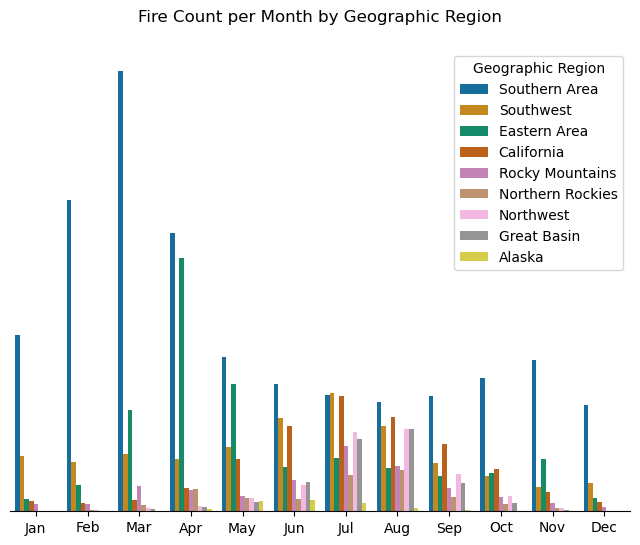

In [10]:
# Now we plot fire count for each region for each month
plt.figure(figsize = (8,6))
sns.barplot(
    by_region_month_df,
    x = "month",
    y = "fire_count",
    hue = "geographic_region",
    palette = sns.color_palette("colorblind")
)
plt.legend(title = "Geographic Region", frameon = True)
plt.title("Fire Count per Month by Geographic Region", pad = 20)
plt.xlabel("")
plt.yticks([])
plt.ylabel("")
sns.despine(left = True)
plt.show()

We see that, alongside the previous animation, fires seem to originate in the south in the beginning of years, and follow a somewhat counter-clockwise pattern across the country, moving east during spring, then north and northeast during beginning of summer, then west and northwest during middle of summer, and then back down at the end of the year. It is also interesting and important to note that most fires occur in the southern area of the country, which might be due to the hotter weather or just how large the region is in comparison to others. 

In [18]:
# Now let's take a look at fire count by federal reporting agency, as well as which states had the largest out-of-state to in-state aid ratio
# We begin by querying fire count by federal agency, not counting local efforts
by_agency_sql = cur.execute(
    """
    SELECT COUNT(f.FIRE_SIZE) AS COUNT, 
           f.NWCG_REPORTING_AGENCY,
           n.GeographicArea
    FROM Fires f
    LEFT JOIN NWCG_UnitIDActive_20170109 n 
    ON f.NWCG_REPORTING_UNIT_ID = n.UnitID
    GROUP BY f.NWCG_REPORTING_AGENCY
    HAVING NWCG_REPORTING_AGENCY != "ST/C&L"
    ORDER BY COUNT DESC
    """
)
by_agency_df = pd.DataFrame(
    data = by_agency_sql.fetchall(),
    columns = [
        "fire_count",
        "federal_agency",
        "geographic_region" 
    ]
)
by_agency_df["federal_agency"].replace(
    to_replace = {
        "FS": "Forest Service",
        "BIA": "Bureau of Indian Affairs",
        "BLM": "Bureau of Land Management",
        "IA": "Interagency Organization",
        "NPS": "National Park Service",
        "FWS": "Fish and Wildlife Service"
    },
    inplace = True
)
by_agency_df["geographic_region"].replace(
    to_replace = {
        "CA": "California", 
        "RM": "Rocky Mountains", 
        "AK": "Alaska"
    },
    inplace = True
)
# Now we will query out-of-state to in-state aid ratio by state
aid_ratio_sql = cur.execute(
    """
    SELECT CAST(t1.count AS REAL)/CAST(t2.count AS REAL) AS RATIO,
           t1.STATE
    FROM (
        SELECT COUNT(f.STATE) AS count,
               f.STATE AS STATE
        FROM Fires f
        LEFT JOIN NWCG_UnitIDActive_20170109 n 
        ON f.NWCG_REPORTING_UNIT_ID = n.UnitID
        WHERE f.STATE != n.State
        GROUP BY f.STATE
    ) t1
    LEFT JOIN (
        SELECT COUNT(f.STATE) AS count,
               f.STATE AS STATE
        FROM Fires f
        LEFT JOIN NWCG_UnitIDActive_20170109 n
        ON f.NWCG_REPORTING_UNIT_ID = n.UnitID
        WHERE f.STATE = n.State
        GROUP BY f.STATE
    ) t2
    ON t1.STATE = t2.STATE
    ORDER BY RATIO DESC
    """
)
aid_ratio_df = pd.DataFrame(
    data = aid_ratio_sql.fetchall(),
    columns = ["ratio", "state"]
)
# Adding column with fire class size modes
fire_class_modes = []
for state in aid_ratio_df.state:
    fire_class_modes += [mode(fires_df[(fires_df["state_fire_origin"] == state) & (fires_df["reporting_agency_state"] != state)].fire_size_class)]
aid_ratio_df["class_modes"] = fire_class_modes
aid_ratio_df["class_modes"].replace(
    to_replace = {"B": "0.26 - 9.9 acres", "A": "<= 0.25 acres"},
    inplace = True
)
# Changing top 10 state codes to full names
aid_ratio_df["state"].replace(
    to_replace = {
        "SD": "South Dakota",
        "WY": "Wyoming",
        "DC": "District of Columbia",
        "WA": "Washington",
        "NV": "Nevada",
        "DE": "Delaware",
        "NM": "New Mexico",
        "OK": "Oklahoma",
        "ID": "Idaho",
        "CA": "California"
    },
    inplace = True
)

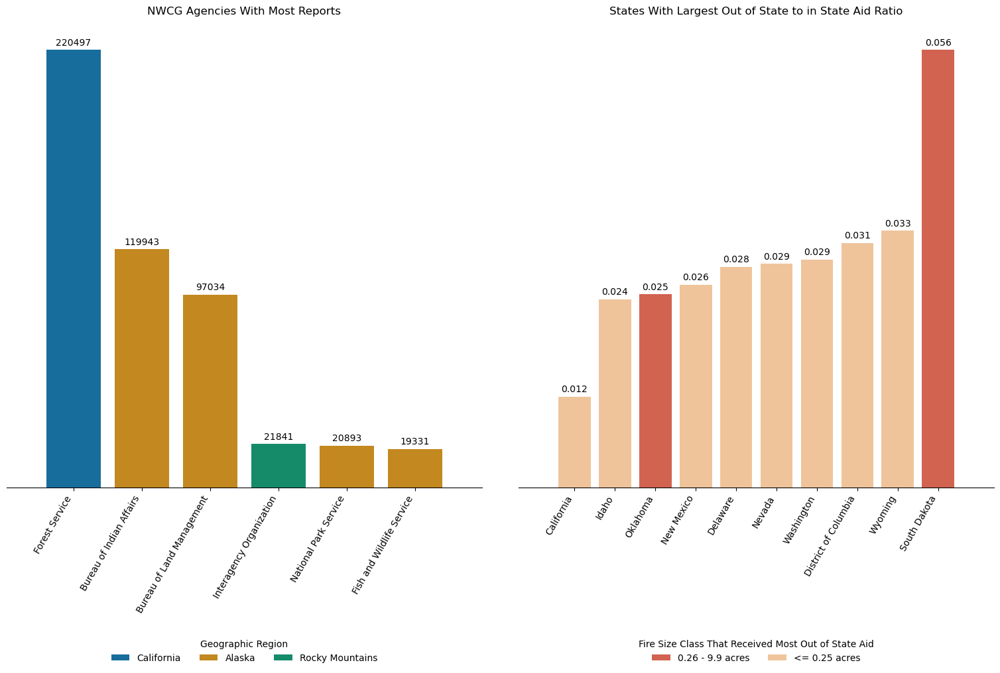

In [19]:
# Now we can plot the top 6 agencies (in terms of number of fires reported) and top 10 states (in terms of number of fires they've needed to rely on out-of-state support relative to fires they've dealt with at home)
# First, top 6 agencies
fig, (ax0, ax1) = plt.subplots(nrows = 1, ncols = 2, figsize = (16,12))
sns.barplot(
    data = by_agency_df.iloc[:6,:], 
    x = "federal_agency",
    y = "fire_count",
    hue = "geographic_region",
    dodge = False,
    palette = sns.color_palette("colorblind"),
    ax = ax0
)
# We add the number of fires to the end of the bars
for container in ax0.containers:
    ax0.bar_label(container, fmt = "%d", padding = 3)
ax0.margins(x = 0.1)
# We move the geographic region labels below the graph
sns.move_legend(
    ax0, 
    "lower center", 
    bbox_to_anchor = (.5, -.4),
    ncol = 3, 
    title = "Geographic Region", 
    frameon = False
)
# Dealing with axes and setting title
ax0.set_xlabel("")
ax0.set_xticks(ax0.get_xticks(), ax0.get_xticklabels(), rotation = 60, ha = "right")
ax0.set_ylabel("")
ax0.set_yticks([])
ax0.set_title("NWCG Agencies With Most Reports", pad = 15)
sns.despine(ax = ax0, left = True, bottom = False)
# Now we plot the top 10 states in terms of the aid ratio
color_palette = sns.color_palette("OrRd", n_colors = 2)
color_palette.reverse()
sns.barplot(
    data = aid_ratio_df.iloc[:10,:],
    x = "state",
    y = "ratio",
    hue = "class_modes",
    dodge = False,
    ax = ax1,
    palette = color_palette
)
# Adding ratio values to the end of bars
for container in ax1.containers:
    ax1.bar_label(container, fmt = "%.3f", padding = 3)
ax1.margins(x = 0.1)
# We move the fire class modes labels below the graph
sns.move_legend(
    ax1, 
    "lower center", 
    bbox_to_anchor = (.5, -.4),
    ncol = 2, 
    title = "Fire Size Class That Received Most Out of State Aid", 
    frameon = False
)
# Dealing with axes (inverting x-axis for readibility) and setting title
ax1.invert_xaxis()
ax1.set_xlabel("")
ax1.set_xticks(ax1.get_xticks(), ax1.get_xticklabels(), rotation = 60, ha = "right")
ax1.set_ylabel("")
ax1.set_yticks([])
ax1.set_title("States With Largest Out of State to in State Aid Ratio", pad = 15)
sns.despine(ax = ax1, bottom = False, right = True, left = True)
plt.tight_layout(pad = 4)
plt.show()

With respect to the leftmost plot, the Forest Service has the most reports out of all the federal agencies, and they deal with fires in the California region. The second region with the most federal assistance is Alaska. Not plotted here is the fact that most fires had reports drafted by state/county/local agencies, so federal assistance isn't the most common response to fires. With respect to the rightmost plot, it seems like South Dakota received the most out of state aid respective to their in state efforts, and most of the fires they received out of state aid for were of class B (these fires are of larger category than most other fires in other states that received out of state aid). If efforts were to be taken to enhance fire prevention and aid, South Dakota would be one of the first states to consider implementing a fire response agency in. 

## 3. How have causes of fires and containment times changed over time?
Now we will take a look at causes of fires and containment times (defined as containment time - discovery time) over the years, attempting to discover if containment times have improved or worsened over the decades, and if certain reasons for fires have become more prevalent.

In [20]:
# Let's begin by looking at causes for fires
# We will first query fire count by cause and month and year
by_cause_month_year_sql = cur.execute(
    """
    SELECT COUNT(FIRE_SIZE),
           STAT_CAUSE_DESCR,
           STRFTIME("%Y-%m", DATE(DISCOVERY_DATE)) AS MY
    FROM Fires
    GROUP BY STAT_CAUSE_DESCR, MY
    ORDER BY MY ASC
    """
)
by_cause_month_year_df = pd.DataFrame(
    data = by_cause_month_year_sql.fetchall(),
    columns = ["fire_count", "cause", "year-month"]
)
by_cause_month_year_df["cause"].replace(
    to_replace = {"Missing/Undefined": "Undefined"},
    inplace = True
)

In [21]:
# Now let's create an animate bar plot to show changes in causes over time
# First, an animation update function that produces new bar plots each frame 
def update_animation(year_month: str) -> None:
    """
    Function that updates animation and then clears axis
    
        Parameters:
            year_month (str): The year and month to change to in the animation
    
        Returns:
            None: Just updates animation, no need to output anything
    """
    bars_pre = by_cause_month_year_df[by_cause_month_year_df["year-month"] == year_month][["cause", "fire_count"]].sort_values(by = "fire_count", ascending = False)
    bars_index = list(bars_pre.cause)
    bars = list(bars_pre.fire_count)
    ax.clear()
    ax.invert_yaxis()
    ax.set_xlabel("Fire Count")
    ax.set_title(f"Fire Count by Cause in {year_month} (Y-M)")
    colors = ["#FFA500", "#FFC100", "#FFD700"]
    ax.barh(bars_index[:3], bars[:3], color = colors, height = 0.7)
    ax.barh(bars_index[3:], bars[3:], color = "tab:blue", height = 0.7)

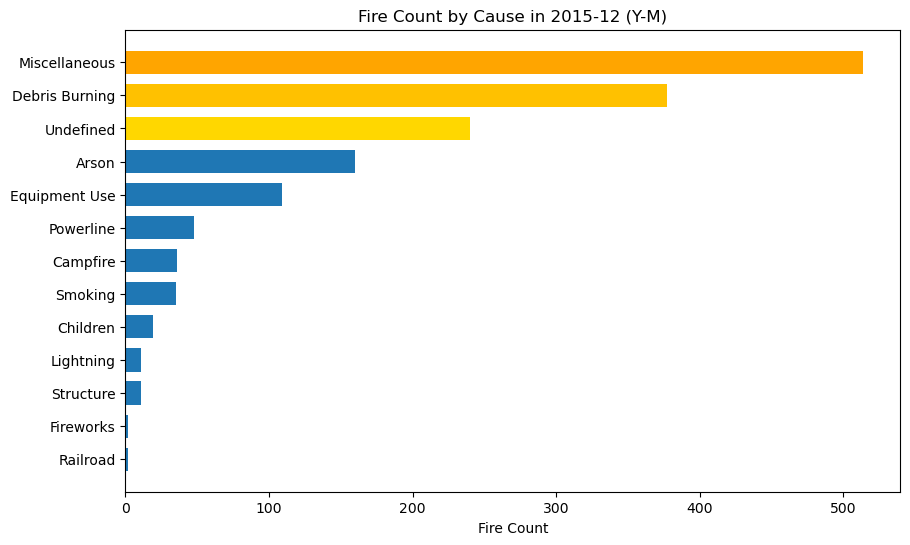

In [22]:
# Now we create the animation
fig, ax = plt.subplots(figsize = (10,6))
animation = FuncAnimation(fig, 
                          update_animation,
                          frames = by_cause_month_year_df["year-month"].unique(),
                          repeat = True,
                          interval = 1000)
from IPython.display import HTML
HTML(animation.to_jshtml())

Now let's take a clearer look at identified fire causes (not miscellaneous nor undefined) over time. To do so, we will group the causes in the following manner:
- Lightning
- Independently Caused (Human): Arson, Smoking, Children, Campfire, Fireworks
- Equipment & Debris Burning: Equipment Use, Debris Burning, Railroad, Powerline, Structure

In [23]:
# Let's proceed by querying the data, taking into account the above mentioned groups
by_sup_cause_pct_month_year_sql = cur.execute(
    """
    SELECT COUNT(f.FIRE_SIZE) As FireCount,
           CASE
            WHEN f.STAT_CAUSE_DESCR = "Lightning" THEN "Lightning"
            WHEN f.STAT_CAUSE_DESCR IN ("Arson", "Smoking", "Children", "Campfire", "Fireworks") THEN "Independently Caused (Human)"
            WHEN f.STAT_CAUSE_DESCR IN ("Equipment Use", "Debris Burning", "Railroad", "Powerline", "Structure") THEN "Equipment, Infrastucture, & Debris Burning"
           END AS Cause,
           STRFTIME("%Y-%m", DATE(f.DISCOVERY_DATE)) AS YearMonth
    FROM Fires f
    LEFT JOIN NWCG_UnitIDActive_20170109 n
    ON f.NWCG_REPORTING_UNIT_ID = n.UnitID
    WHERE f.STAT_CAUSE_DESCR NOT IN ("Miscellaneous", "Missing/Undefined")
    GROUP BY Cause, YearMonth
    ORDER BY YearMonth ASC
    """
)
by_sup_cause_pct_month_year_df = pd.DataFrame(
    data = by_sup_cause_pct_month_year_sql.fetchall(),
    columns = ["Fire Count Percentage", "Fire Cause", "Year-Month"]
)
for year_month in by_sup_cause_pct_month_year_df["Year-Month"].unique():
    total = sum(by_sup_cause_pct_month_year_df[by_sup_cause_pct_month_year_df["Year-Month"] == year_month]["Fire Count Percentage"])
    by_sup_cause_pct_month_year_df.loc[by_sup_cause_pct_month_year_df["Year-Month"] == year_month, "Fire Count Percentage"] /= total/100


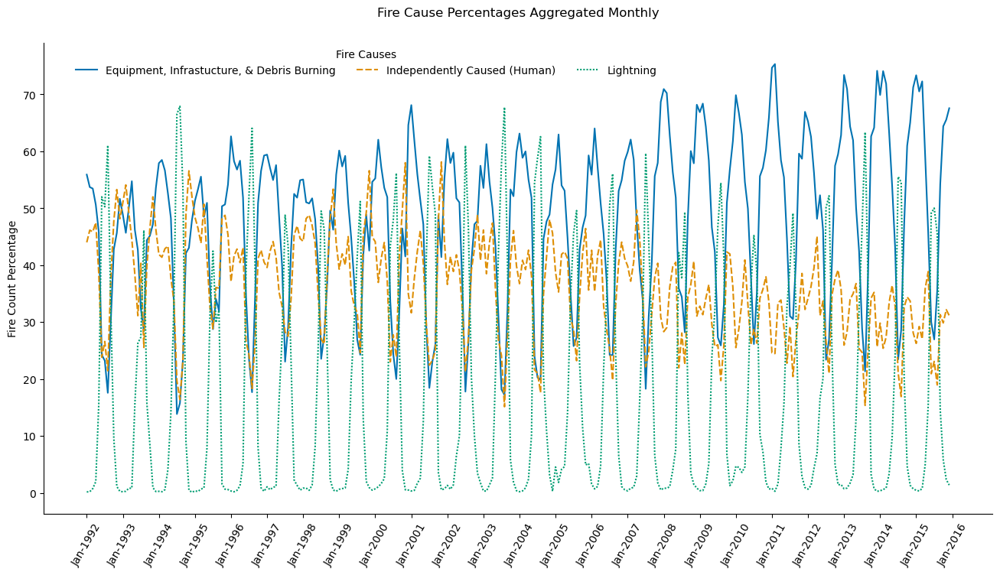

In [135]:
# Plotting monthly fire count percentages by cause
plt.figure(figsize = (16,8)) 
sns.lineplot(
    by_sup_cause_pct_month_year_df, 
    x = "Year-Month", 
    y = by_sup_cause_pct_month_year_df["Fire Count Percentage"],
    hue = "Fire Cause",
    style = "Fire Cause",
    palette = sns.color_palette("colorblind", n_colors = 3)
)
plt.gca().set_xticks(
    ticks = np.linspace(0, len(by_sup_cause_pct_month_year_df["Year-Month"].unique()), 25),
    labels = ["Jan-" + str(int(x)) for x in np.linspace(1992, 2016, 25)],
    rotation = 60
)
plt.xlabel("")
plt.legend(
    loc = "lower center", 
    bbox_to_anchor = (.34, 0.91),
    ncol = 3, 
    title = "Fire Causes", 
    frameon = False
)
plt.title("Fire Cause Percentages Aggregated Monthly", pad = 25)
sns.despine()
plt.show()

We see two things in this graph: first, equipment, infrastructure, and debris burning fires are on the up whilst independently caused fires are decreasing. Second, there is a seasonality to fire causes, where fires are more likely to be caused by lightning strikes during the hotter months than the colder months. We should check whether the seasonal aspect of the causes is due purely an increase in lightning strikes or also a decrease in human activity. To do so, let's plot fire count for human-caused fires vs. lightning caused fires.

In [25]:
# Let's proceed by querying the data 
by_sup_cause_month_year_sql = cur.execute(
    """
    SELECT COUNT(f.FIRE_SIZE) As FireCount,
           CASE
            WHEN f.STAT_CAUSE_DESCR = "Lightning" THEN "Lightning"
            WHEN f.STAT_CAUSE_DESCR IN ("Arson", "Smoking", "Children", "Campfire", "Fireworks", "Equipment Use", "Debris Burning", "Railroad", "Powerline", "Structure") THEN "Human"
           END AS Cause,
           STRFTIME("%Y-%m", DATE(f.DISCOVERY_DATE)) AS YearMonth
    FROM Fires f
    LEFT JOIN NWCG_UnitIDActive_20170109 n
    ON f.NWCG_REPORTING_UNIT_ID = n.UnitID
    WHERE f.STAT_CAUSE_DESCR NOT IN ("Miscellaneous", "Missing/Undefined")
    GROUP BY Cause, YearMonth
    ORDER BY YearMonth ASC
    """
)
by_sup_cause_month_year_df = pd.DataFrame(
    data = by_sup_cause_month_year_sql.fetchall(),
    columns = ["Fire Count", "Fire Cause", "Year-Month"]
)

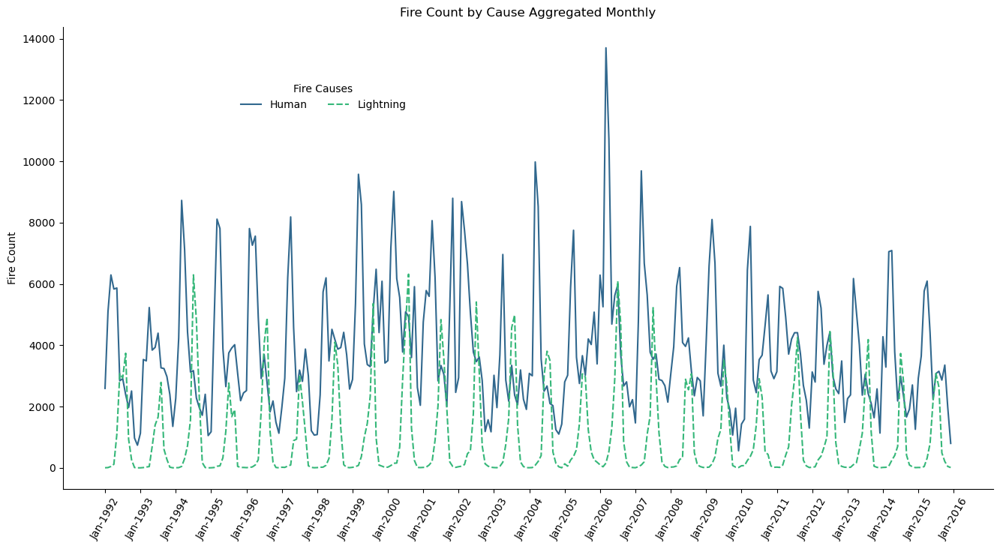

In [138]:
# Plotting monthly fire count by cause
plt.figure(figsize = (16,8)) 
sns.lineplot(
    by_sup_cause_month_year_df, 
    x = "Year-Month", 
    y = by_sup_cause_month_year_df["Fire Count"],
    hue = "Fire Cause",
    style = "Fire Cause",
    palette = sns.color_palette("viridis", n_colors = 2)
)
plt.gca().set_xticks(
    ticks = np.linspace(0, len(by_sup_cause_month_year_df["Year-Month"].unique()), 25),
    labels = ["Jan-" + str(int(x)) for x in np.linspace(1992, 2016, 25)],
    rotation = 60
)
plt.xlabel("")
plt.legend(
    loc = "lower center", 
    bbox_to_anchor = (.28, 0.8),
    ncol = 2, 
    title = "Fire Causes", 
    frameon = False
)
plt.title("Fire Count by Cause Aggregated Monthly", pad = 10)
sns.despine()
plt.show()

Human caused fires seem to not be as seasonal in nature as lightning caused fires, although human caused fires tend to decrease after an uptick in lightning caused fires. This could be interesting to delve further into, as it could be reactionary or already implemented as a precaution in law and/or industrial regulation.

In [121]:
# Now let's take a look at containment times
# Beginning with querying the data, defining containment time as time in which fire was put out - time in which fire was discovered
containment_time_sql = cur.execute(
    """
    WITH Time AS (
                    SELECT 
                        FOD_ID,
                        DATETIME(DATE(DISCOVERY_DATE) || " " || SUBSTR(DISCOVERY_TIME, 1, 2) || ":" || SUBSTR(DISCOVERY_TIME, 3, 4)) AS discovery_time,
                        DATETIME(DATE(CONT_DATE) || " " || SUBSTR(CONT_TIME, 1, 2) || ":" || SUBSTR(CONT_TIME, 3, 4)) AS putout_time
                    FROM Fires
                    WHERE putout_time != "None"
    )
    SELECT
        t.discovery_time,
        t.putout_time,
        STRFTIME("%Y-%m", DATE(f.CONT_DATE)) AS putout_YM
    FROM Fires f
    JOIN Time t ON f.FOD_ID = t.FOD_ID
    """
)
containment_time_df = pd.DataFrame(
    data = containment_time_sql.fetchall(),
    columns = ["Discovery Time", "Putout Time", "Year-Month"]
)
# Calculating containment times in hours
containment_time_df["Discovery Time"] = pd.to_datetime(containment_time_df["Discovery Time"])
containment_time_df["Putout Time"] = pd.to_datetime(containment_time_df["Putout Time"])
containment_times = []
for i in range(len(containment_time_df)):
    t2 = containment_time_df.loc[i, "Putout Time"]
    t1 = containment_time_df.loc[i, "Discovery Time"]
    containment_times += [pd.Timedelta(t2 - t1).seconds/3600]
containment_time_df["Average Containment Time"] = containment_times
# Now making pivot to aggregate over year-months
containment_time_df = pd.pivot_table(
    containment_time_df,
    values = "Average Containment Time",
    index = "Year-Month",
    aggfunc = "mean"
)

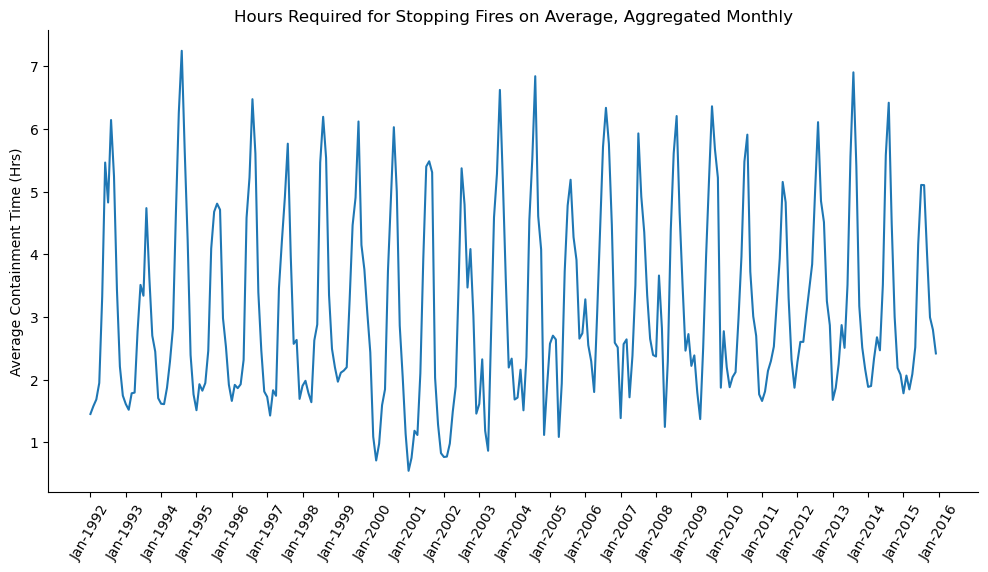

In [ ]:
# Now plotting monthly average containment time over the years
plt.figure(figsize = (12,6))
sns.lineplot(
    containment_time_df,
    x = "Year-Month",
    y = "Average Containment Time"
)
plt.gca().set_xticks(
    ticks = np.linspace(0, len(containment_time_df.index.unique()), 25),
    labels = ["Jan-" + str(int(x)) for x in np.linspace(1992, 2016, 25)],
    rotation = 60
)
plt.xlabel("")
plt.ylabel("Average Containment Time (Hrs)")
plt.title("Hours Needed to Stop Fires on Average, Aggregated Monthly")
sns.despine()
plt.show()


From this plot and the previous ones, we can see that most fires occur in the summer season, positively correlating with the amount of time required to put them out. Given that human-caused fires seem to decrease as a reaction to more lightning-caused fires appearing in the summer season, maybe more efforts should be made to increase fire precautions during the drier months. Also, it does not seem like average containment times have changed over the years, indicating that there hasn't been much evolution in terms of wildfire response. More efforts should thus be placed into preemptive wildfire defense for the summer season, as well as into reactive wildfire stoppage once they appear.